In [292]:
# Required Modules
import pandas as pd
import numpy as np
import lazypredict
import warnings
warnings.filterwarnings("ignore")

from scipy import stats

from sklearn import metrics
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_log_error
from math import sqrt

from statsmodels.tsa.vector_ar.var_model import VAR


from lazypredict.Supervised import LazyRegressor
from lazypredict.Supervised import LazyClassifier

from lightgbm import LGBMRegressor
from lightgbm import LGBMClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LogisticRegression

In [164]:
data = pd.read_csv('Resources/Final_Data.csv')
data.head()

,Zip_Code,Date,Date_Code,Year,Month,Sale_Price,Interest_Rate,Property_Tax,Rent_Price,Household_Income,...,FTE_Employed,Unemployed,Expense_Index,Average_Commute,Crime_Index,Loan_Amount,Loan_Term,Loan_R,Loan_Payment,Home_Affordability
0,32003,2019-01-01,201901,2019,1,244950.00,4.46,3778,1113,94154.00,...,10671,1069,104,35,28,195960.00,360.00,1.00,988.71,0.13
1,32003,2019-02-01,201902,2019,2,270000.00,4.37,3778,1113,94154.00,...,10671,1069,104,35,28,216000.00,360.00,1.00,1077.82,0.14
2,32003,2019-03-01,201903,2019,3,275000.00,4.26,3778,1113,94154.00,...,10671,1069,104,35,28,220000.00,360.00,1.00,1084.20,0.14
3,32003,2019-04-01,201904,2019,4,264500.00,4.14,3778,1113,94154.00,...,10671,1069,104,35,28,211600.00,360.00,1.00,1027.67,0.13
4,32003,2019-05-01,201905,2019,5,281000.00,4.07,3778,1113,94154.00,...,10671,1069,104,35,28,224800.00,360.00,1.00,1082.58,0.14


In [293]:
test = data[['Zip_Code', 'Date_Code', 'Mobility_Rate', 'Expense_Index', 'Crime_Index' , 'Total_Vacant', 'Total_Dwellings', 'Total_Sales', 'FHA_Count', 'Home_Affordability', 'Rent_Affordability', 'Sale_Price' ]]
test.head()

,Zip_Code,Date_Code,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price
0,32003,201901,0.18,104,28,704,11724,32,7,0.13,0.14,244950.00
1,32003,201902,0.18,104,28,704,11724,41,2,0.14,0.14,270000.00
2,32003,201903,0.18,104,28,704,11724,21,7,0.14,0.14,275000.00
3,32003,201904,0.18,104,28,704,11724,42,3,0.13,0.14,264500.00
4,32003,201905,0.18,104,28,704,11724,66,8,0.14,0.14,281000.00


In [3]:
ml_data = data[['Zip_Code', 'Year', 'Month', 'Mobility_Rate', 'Expense_Index', 'Crime_Index' , 'Total_Vacant', 'Total_Dwellings', 'Total_Sales', 'FHA_Count', 'Home_Affordability', 'Rent_Affordability', 'Sale_Price' ]]
# ml_data.index = ml_data['Zip_Code']
ml_data

,Zip_Code,Year,Month,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price
0,32003,2019,1,0.18,104,28,704,11724,32,7,0.13,0.14,244950.00
1,32003,2019,2,0.18,104,28,704,11724,41,2,0.14,0.14,270000.00
2,32003,2019,3,0.18,104,28,704,11724,21,7,0.14,0.14,275000.00
3,32003,2019,4,0.18,104,28,704,11724,42,3,0.13,0.14,264500.00
4,32003,2019,5,0.18,104,28,704,11724,66,8,0.14,0.14,281000.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...
24377,34997,2021,1,0.14,91,113,2976,21551,81,10,0.20,0.25,305000.00
24378,34997,2021,2,0.14,91,113,2976,21551,116,7,0.20,0.25,300000.00
24379,34997,2021,2,0.14,91,113,2976,21551,116,7,0.20,0.25,300000.00
24380,34997,2021,3,0.14,91,113,2976,21551,7,12,0.42,0.25,599000.00


In [4]:
ml_data.dtypes

Zip_Code                int64
Year                    int64
Month                   int64
Mobility_Rate         float64
Expense_Index           int64
Crime_Index             int64
Total_Vacant            int64
Total_Dwellings         int64
Total_Sales             int64
FHA_Count               int64
Home_Affordability    float64
Rent_Affordability    float64
Sale_Price            float64
dtype: object

In [5]:
count = np.isinf(ml_data).values.sum()
print("It contains " + str(count) + " infinite values")

It contains 0 infinite values


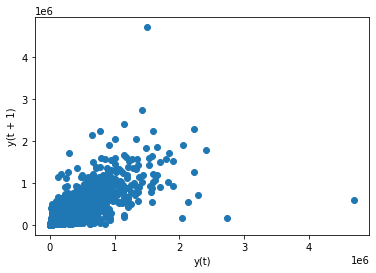

In [6]:
from pandas.plotting import lag_plot
lag_plot(ml_data)

In [42]:
ml_data_3mo = ml_data.sort_values(by = ['Zip_Code', 'Year', 'Month'], ascending = [True, True, True])
ml_data_3mo.head()

,Zip_Code,Year,Month,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price
0,32003,2019,1,0.18,104,28,704,11724,32,7,0.13,0.14,244950.00
1,32003,2019,2,0.18,104,28,704,11724,41,2,0.14,0.14,270000.00
2,32003,2019,3,0.18,104,28,704,11724,21,7,0.14,0.14,275000.00
3,32003,2019,4,0.18,104,28,704,11724,42,3,0.13,0.14,264500.00
4,32003,2019,5,0.18,104,28,704,11724,66,8,0.14,0.14,281000.00


In [43]:
ml_data_3mo['Last_Month_Price'] = ml_data_3mo.groupby(['Zip_Code'])['Sale_Price'].shift()
ml_data_3mo['Last_2Month_Price'] = ml_data_3mo.groupby(['Zip_Code'])['Sale_Price'].shift(2)
ml_data_3mo['Last_3Month_Price'] = ml_data_3mo.groupby(['Zip_Code'])['Sale_Price'].shift(3)
# ml_data_3mo['Future_Month_Price'] = ml_data_3mo.groupby(['Zip_Code'])['Sale_Price'].shift(-1)
# ml_data_3mo['Future_2Month_Price'] = ml_data_3mo.groupby(['Zip_Code'])['Sale_Price'].shift(-2)
# ml_data_3mo['Future_3Month_Price'] = ml_data_3mo.groupby(['Zip_Code'])['Sale_Price'].shift(-3)


price_difference_1 = []
price_difference_2 = []
price_difference_3 = []


for column in ml_data_3mo[['Sale_Price', 'Last_Month_Price', 'Last_2Month_Price',
                    'Last_3Month_Price']]:
   # Select column contents by column name using [] operator
    current_sales = ml_data_3mo['Sale_Price'].values
    last_sales = ml_data_3mo['Last_Month_Price'].values
    last_2mo_sale = ml_data_3mo['Last_2Month_Price'].values
    last_3mo_sale = ml_data_3mo['Last_3Month_Price'].values
    price_difference_1.append(current_sales-last_sales)
    price_difference_2.append(last_sales-last_2mo_sale)
    price_difference_3.append(last_2mo_sale-last_3mo_sale)
    

ml_data_3mo['Last_Month_Diff'] = price_difference_1[0]
ml_data_3mo['Last_2Month_Diff'] = price_difference_2[0]
ml_data_3mo['Last_3Month_Diff'] = price_difference_3[0]

ml_data_3mo

,Zip_Code,Year,Month,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price,Last_Month_Price,Last_2Month_Price,Last_3Month_Price,Last_Month_Diff,Last_2Month_Diff,Last_3Month_Diff
0,32003,2019,1,0.18,104,28,704,11724,32,7,0.13,0.14,244950.00,nan,nan,nan,nan,nan,nan
1,32003,2019,2,0.18,104,28,704,11724,41,2,0.14,0.14,270000.00,244950.00,nan,nan,25050.00,nan,nan
2,32003,2019,3,0.18,104,28,704,11724,21,7,0.14,0.14,275000.00,270000.00,244950.00,nan,5000.00,25050.00,nan
3,32003,2019,4,0.18,104,28,704,11724,42,3,0.13,0.14,264500.00,275000.00,270000.00,244950.00,-10500.00,5000.00,25050.00
4,32003,2019,5,0.18,104,28,704,11724,66,8,0.14,0.14,281000.00,264500.00,275000.00,270000.00,16500.00,-10500.00,5000.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24377,34997,2021,1,0.14,91,113,2976,21551,81,10,0.20,0.25,305000.00,305000.00,297000.00,297000.00,0.00,8000.00,0.00
24378,34997,2021,2,0.14,91,113,2976,21551,116,7,0.20,0.25,300000.00,305000.00,305000.00,297000.00,-5000.00,0.00,8000.00
24379,34997,2021,2,0.14,91,113,2976,21551,116,7,0.20,0.25,300000.00,300000.00,305000.00,305000.00,0.00,-5000.00,0.00
24380,34997,2021,3,0.14,91,113,2976,21551,7,12,0.42,0.25,599000.00,300000.00,300000.00,305000.00,299000.00,0.00,-5000.00


In [44]:
ml_data_3mo.replace([np.inf, -np.inf], np.nan, inplace=True)
ml_data_3mo.dropna(inplace=True)
ml_data_3mo.head()

,Zip_Code,Year,Month,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price,Last_Month_Price,Last_2Month_Price,Last_3Month_Price,Last_Month_Diff,Last_2Month_Diff,Last_3Month_Diff
3,32003,2019,4,0.18,104,28,704,11724,42,3,0.13,0.14,264500.00,275000.00,270000.00,244950.00,-10500.00,5000.00,25050.00
4,32003,2019,5,0.18,104,28,704,11724,66,8,0.14,0.14,281000.00,264500.00,275000.00,270000.00,16500.00,-10500.00,5000.00
5,32003,2019,6,0.18,104,28,704,11724,43,3,0.13,0.14,275000.00,281000.00,264500.00,275000.00,-6000.00,16500.00,-10500.00
6,32003,2019,7,0.18,104,28,704,11724,90,7,0.13,0.14,282500.00,275000.00,281000.00,264500.00,7500.00,-6000.00,16500.00
7,32003,2019,8,0.18,104,28,704,11724,64,5,0.13,0.14,269577.00,282500.00,275000.00,281000.00,-12923.00,7500.00,-6000.00


In [31]:
ml_gran_test = ml_data_3mo[ml_data_3mo['Zip_Code'] ==32603]
ml_gran_test

,Zip_Code,Year,Month,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price,Last_Month_Price,Last_2Month_Price,Last_3Month_Price,Last_Month_Diff,Last_2Month_Diff,Last_3Month_Diff
5293,32603,2019,4,0.59,57,299,209,2371,6,0,0.59,0.63,260000.00,207500.00,246500.00,270000.00,52500.00,-39000.00,-23500.00
5294,32603,2019,5,0.59,57,299,209,2371,9,0,0.63,0.63,280000.00,260000.00,207500.00,246500.00,20000.00,52500.00,-39000.00
5295,32603,2019,6,0.59,57,299,209,2371,1,0,0.67,0.63,310000.00,280000.00,260000.00,207500.00,30000.00,20000.00,52500.00
5296,32603,2019,7,0.59,57,299,209,2371,4,0,0.67,0.63,311750.00,310000.00,280000.00,260000.00,1750.00,30000.00,20000.00
5297,32603,2019,8,0.59,57,299,209,2371,1,0,0.40,0.63,187400.00,311750.00,310000.00,280000.00,-124350.00,1750.00,30000.00
5298,32603,2019,9,0.59,57,299,209,2371,4,0,0.55,0.63,262500.00,187400.00,311750.00,310000.00,75100.00,-124350.00,1750.00
5299,32603,2019,10,0.59,57,299,209,2371,2,0,0.72,0.63,339450.00,262500.00,187400.00,311750.00,76950.00,75100.00,-124350.00
5300,32603,2019,11,0.59,57,299,209,2371,2,0,0.46,0.63,215000.00,339450.00,262500.00,187400.00,-124450.00,76950.00,75100.00
5301,32603,2019,12,0.59,57,299,209,2371,3,0,0.50,0.63,231000.00,215000.00,339450.00,262500.00,16000.00,-124450.00,76950.00
5302,32603,2020,1,0.59,57,299,209,2371,6,0,0.65,0.63,305750.00,231000.00,215000.00,339450.00,74750.00,16000.00,-124450.00


In [34]:
from statsmodels.tsa.stattools import grangercausalitytests
maxlag=5
test = 'ssr_chi2test'
def grangers_causation_matrix(data, variables, test='ssr_chi2test', verbose=False):    
    """Check Granger Causality of all possible combinations of the Time series.
    The rows are the response variable, columns are predictors. The values in the table 
    are the P-Values. P-Values lesser than the significance level (0.05), implies 
    the Null Hypothesis that the coefficients of the corresponding past values is 
    zero, that is, the X does not cause Y can be rejected.

    data      : pandas dataframe containing the time series variables
    variables : list containing names of the time series variables.
    """
    df = pd.DataFrame(np.zeros((len(variables), len(variables))), columns=variables, index=variables)
    for c in df.columns:
        for r in df.index:
            test_result = grangercausalitytests(data[[r, c]], maxlag=maxlag, verbose=False)
            p_values = [round(test_result[i+1][0][test][1],4) for i in range(maxlag)]
            if verbose: print(f'Y = {r}, X = {c}, P Values = {p_values}')
            min_p_value = np.min(p_values)
            df.loc[r, c] = min_p_value
    df.columns = [var + '_x' for var in variables]
    df.index = [var + '_y' for var in variables]
    return df

grangers_causation_matrix(ml_data_3mo, variables = ml_data_3mo.columns)   

,Zip_Code_x,Year_x,Month_x,Mobility_Rate_x,Expense_Index_x,Crime_Index_x,Total_Vacant_x,Total_Dwellings_x,Total_Sales_x,FHA_Count_x,Home_Affordability_x,Rent_Affordability_x,Sale_Price_x,Last_Month_Price_x,Last_2Month_Price_x,Last_3Month_Price_x,Last_Month_Diff_x,Last_2Month_Diff_x,Last_3Month_Diff_x
Zip_Code_y,1.00,0.00,0.00,0.97,0.67,0.19,0.61,0.81,0.00,0.00,0.01,0.20,0.06,0.14,0.32,0.16,0.11,0.13,0.09
Year_y,0.00,1.00,0.00,0.85,0.84,0.94,0.98,0.93,0.00,0.00,0.00,0.95,0.00,0.00,0.00,0.00,0.06,0.02,0.02
Month_y,0.00,0.00,1.00,0.88,0.91,0.95,0.94,0.83,0.00,0.00,0.00,0.97,0.01,0.02,0.00,0.00,0.00,0.01,0.02
Mobility_Rate_y,0.10,0.76,0.32,1.00,0.04,0.33,0.30,0.78,0.77,0.15,0.35,0.94,0.58,0.48,0.56,0.36,0.77,0.73,0.47
Expense_Index_y,0.48,0.62,0.46,0.58,1.00,0.08,0.01,0.00,0.00,0.06,0.00,0.02,0.02,0.02,0.02,0.09,0.59,0.48,0.29
Crime_Index_y,0.21,0.89,0.95,0.19,0.16,1.00,0.66,0.63,0.72,0.45,0.01,0.92,0.00,0.00,0.00,0.00,0.00,0.85,0.58
Total_Vacant_y,0.00,0.58,0.05,0.36,0.12,0.38,1.00,0.87,0.00,0.01,0.22,0.51,0.11,0.10,0.17,0.28,0.08,0.06,0.57
Total_Dwellings_y,0.12,0.11,0.00,0.04,0.02,0.01,0.90,1.00,0.00,0.00,0.20,0.16,0.02,0.01,0.00,0.02,0.53,0.31,0.30
Total_Sales_y,0.00,0.00,0.00,0.00,0.36,0.07,0.00,0.00,1.00,0.00,0.11,0.00,0.00,0.00,0.00,0.00,0.27,0.07,0.02
FHA_Count_y,0.00,0.00,0.00,0.63,0.00,0.48,0.00,0.00,0.00,1.00,0.01,0.26,0.00,0.00,0.00,0.00,0.07,0.62,0.71


In [45]:
predict_21 = ml_data_3mo[ml_data_3mo['Year'] == 2021]

predict_21

,Zip_Code,Year,Month,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price,Last_Month_Price,Last_2Month_Price,Last_3Month_Price,Last_Month_Diff,Last_2Month_Diff,Last_3Month_Diff
24,32003,2021,1,0.18,104,28,704,11724,39,6,0.12,0.14,299900.00,294000.00,336000.00,330000.00,5900.00,-42000.00,6000.00
25,32003,2021,2,0.18,104,28,704,11724,30,8,0.14,0.14,333800.00,299900.00,294000.00,336000.00,33900.00,5900.00,-42000.00
26,32003,2021,3,0.18,104,28,704,11724,70,4,0.15,0.14,339950.00,333800.00,299900.00,294000.00,6150.00,33900.00,5900.00
50,32008,2021,1,0.07,82,118,964,3247,6,0,0.15,0.29,132000.00,169500.00,72500.00,107000.00,-37500.00,97000.00,-34500.00
51,32008,2021,2,0.07,82,118,964,3247,3,1,0.06,0.29,53200.00,132000.00,169500.00,72500.00,-78800.00,-37500.00,97000.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24377,34997,2021,1,0.14,91,113,2976,21551,81,10,0.20,0.25,305000.00,305000.00,297000.00,297000.00,0.00,8000.00,0.00
24378,34997,2021,2,0.14,91,113,2976,21551,116,7,0.20,0.25,300000.00,305000.00,305000.00,297000.00,-5000.00,0.00,8000.00
24379,34997,2021,2,0.14,91,113,2976,21551,116,7,0.20,0.25,300000.00,300000.00,305000.00,305000.00,0.00,-5000.00,0.00
24380,34997,2021,3,0.14,91,113,2976,21551,7,12,0.42,0.25,599000.00,300000.00,300000.00,305000.00,299000.00,0.00,-5000.00


In [36]:
predict_21 = predict_21.drop(columns=['Zip_Code', 'Year', 'Month'])
predict_21

,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price,Last_Month_Price,Last_2Month_Price,Last_3Month_Price,Last_Month_Diff,Last_2Month_Diff,Last_3Month_Diff
24,0.18,104,28,704,11724,39,6,0.12,0.14,299900.00,294000.00,336000.00,330000.00,5900.00,-42000.00,6000.00
25,0.18,104,28,704,11724,30,8,0.14,0.14,333800.00,299900.00,294000.00,336000.00,33900.00,5900.00,-42000.00
26,0.18,104,28,704,11724,70,4,0.15,0.14,339950.00,333800.00,299900.00,294000.00,6150.00,33900.00,5900.00
50,0.07,82,118,964,3247,6,0,0.15,0.29,132000.00,169500.00,72500.00,107000.00,-37500.00,97000.00,-34500.00
51,0.07,82,118,964,3247,3,1,0.06,0.29,53200.00,132000.00,169500.00,72500.00,-78800.00,-37500.00,97000.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24377,0.14,91,113,2976,21551,81,10,0.20,0.25,305000.00,305000.00,297000.00,297000.00,0.00,8000.00,0.00
24378,0.14,91,113,2976,21551,116,7,0.20,0.25,300000.00,305000.00,305000.00,297000.00,-5000.00,0.00,8000.00
24379,0.14,91,113,2976,21551,116,7,0.20,0.25,300000.00,300000.00,305000.00,305000.00,0.00,-5000.00,0.00
24380,0.14,91,113,2976,21551,7,12,0.42,0.25,599000.00,300000.00,300000.00,305000.00,299000.00,0.00,-5000.00


In [37]:
y_test = predict_21['Sale_Price'].values

X_test = predict_21.drop(columns='Sale_Price')

feature_test_names = X_test.columns

X_test

,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Last_Month_Price,Last_2Month_Price,Last_3Month_Price,Last_Month_Diff,Last_2Month_Diff,Last_3Month_Diff
24,0.18,104,28,704,11724,39,6,0.12,0.14,294000.00,336000.00,330000.00,5900.00,-42000.00,6000.00
25,0.18,104,28,704,11724,30,8,0.14,0.14,299900.00,294000.00,336000.00,33900.00,5900.00,-42000.00
26,0.18,104,28,704,11724,70,4,0.15,0.14,333800.00,299900.00,294000.00,6150.00,33900.00,5900.00
50,0.07,82,118,964,3247,6,0,0.15,0.29,169500.00,72500.00,107000.00,-37500.00,97000.00,-34500.00
51,0.07,82,118,964,3247,3,1,0.06,0.29,132000.00,169500.00,72500.00,-78800.00,-37500.00,97000.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24377,0.14,91,113,2976,21551,81,10,0.20,0.25,305000.00,297000.00,297000.00,0.00,8000.00,0.00
24378,0.14,91,113,2976,21551,116,7,0.20,0.25,305000.00,305000.00,297000.00,-5000.00,0.00,8000.00
24379,0.14,91,113,2976,21551,116,7,0.20,0.25,300000.00,305000.00,305000.00,0.00,-5000.00,0.00
24380,0.14,91,113,2976,21551,7,12,0.42,0.25,300000.00,300000.00,305000.00,299000.00,0.00,-5000.00


In [41]:
ml_data_3mo = ml_data_3mo[ml_data_3mo['Year'] < 2021]
ml_data_3mo.head()

KeyError: 'Year'

In [39]:
# ml_data_3mo = ml_data_3mo.drop(columns=['Zip_Code', 'Year', 'Month', 'Last_Month_Price',
#                         'Last_2Month_Price', 'Last_2Month_Price', 'Last_Month_Diff',
#                         'Last_2Month_Diff', 'Last_3Month_Price', 'Last_3Month_Diff'])
# ml_data_3mo

ml_data_3mo = ml_data_3mo.drop(columns=['Zip_Code', 'Year', 'Month'])
ml_data_3mo

,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price,Last_Month_Price,Last_2Month_Price,Last_3Month_Price,Last_Month_Diff,Last_2Month_Diff,Last_3Month_Diff
3,0.18,104,28,704,11724,42,3,0.13,0.14,264500.00,275000.00,270000.00,244950.00,-10500.00,5000.00,25050.00
4,0.18,104,28,704,11724,66,8,0.14,0.14,281000.00,264500.00,275000.00,270000.00,16500.00,-10500.00,5000.00
5,0.18,104,28,704,11724,43,3,0.13,0.14,275000.00,281000.00,264500.00,275000.00,-6000.00,16500.00,-10500.00
6,0.18,104,28,704,11724,90,7,0.13,0.14,282500.00,275000.00,281000.00,264500.00,7500.00,-6000.00,16500.00
7,0.18,104,28,704,11724,64,5,0.13,0.14,269577.00,282500.00,275000.00,281000.00,-12923.00,7500.00,-6000.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24371,0.14,91,113,2976,21551,139,17,0.19,0.25,285000.00,285000.00,256000.00,256000.00,0.00,29000.00,0.00
24372,0.14,91,113,2976,21551,132,11,0.17,0.25,259750.00,285000.00,285000.00,256000.00,-25250.00,0.00,29000.00
24373,0.14,91,113,2976,21551,132,11,0.17,0.25,259750.00,259750.00,285000.00,285000.00,0.00,-25250.00,0.00
24374,0.14,91,113,2976,21551,142,16,0.20,0.25,297000.00,259750.00,259750.00,285000.00,37250.00,0.00,-25250.00


In [40]:
y_train= ml_data_3mo['Sale_Price'].values

X_train = ml_data_3mo.drop(columns='Sale_Price')

feature_train_names = X_train.columns

X_train

,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Last_Month_Price,Last_2Month_Price,Last_3Month_Price,Last_Month_Diff,Last_2Month_Diff,Last_3Month_Diff
3,0.18,104,28,704,11724,42,3,0.13,0.14,275000.00,270000.00,244950.00,-10500.00,5000.00,25050.00
4,0.18,104,28,704,11724,66,8,0.14,0.14,264500.00,275000.00,270000.00,16500.00,-10500.00,5000.00
5,0.18,104,28,704,11724,43,3,0.13,0.14,281000.00,264500.00,275000.00,-6000.00,16500.00,-10500.00
6,0.18,104,28,704,11724,90,7,0.13,0.14,275000.00,281000.00,264500.00,7500.00,-6000.00,16500.00
7,0.18,104,28,704,11724,64,5,0.13,0.14,282500.00,275000.00,281000.00,-12923.00,7500.00,-6000.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24371,0.14,91,113,2976,21551,139,17,0.19,0.25,285000.00,256000.00,256000.00,0.00,29000.00,0.00
24372,0.14,91,113,2976,21551,132,11,0.17,0.25,285000.00,285000.00,256000.00,-25250.00,0.00,29000.00
24373,0.14,91,113,2976,21551,132,11,0.17,0.25,259750.00,285000.00,285000.00,0.00,-25250.00,0.00
24374,0.14,91,113,2976,21551,142,16,0.20,0.25,259750.00,259750.00,285000.00,37250.00,0.00,-25250.00


# Random Forest Regressor

In [30]:
#Random Forest Regressor
rf_regr = RandomForestRegressor(n_estimators=1000, n_jobs=-1, random_state=42)
rf_regr.fit(X_train, y_train)

RandomForestRegressor(n_estimators=1000, n_jobs=-1, random_state=42)

In [31]:
print(f"Training Data Score: {rf_regr.score(X_train, y_train)}")
print(f"Testing Data Score: {rf_regr.score(X_test, y_test)}")

Training Data Score: 0.998261590175127
Testing Data Score: 0.9783895595652402


In [32]:
def rmsle(ytrue, ypred):
    return np.sqrt(mean_squared_log_error(ytrue, ypred))

In [36]:
rf_pred = rf_regr.predict(X_test)

error = rmsle(y_test, rf_pred)
    
print('Mean Error = %.5f' % np.mean(error))

Mean Error = 0.07033


In [37]:
output = pd.DataFrame({'Predicted':rf_pred, 'Actual': y_test})
output

,Predicted,Actual
0,300614.62,299900.00
1,333581.20,333800.00
2,339494.40,339950.00
3,132370.02,132000.00
4,65174.46,53200.00
...,...,...
2612,305592.64,305000.00
2613,300558.48,300000.00
2614,300017.08,300000.00
2615,537985.57,599000.00


In [72]:
from sklearn.model_selection import GridSearchCV
param_grid = {'n_estimators': [100, 500, 1000,]}
grid = GridSearchCV(rf_regr, param_grid, verbose=3)
grid

GridSearchCV(estimator=RandomForestRegressor(n_estimators=1000, n_jobs=-1,
                                             random_state=42),
             param_grid={'n_estimators': [100, 500, 1000]}, verbose=3)

In [73]:
grid.fit(X_train, y_train)

Fitting 5 folds for each of 3 candidates, totalling 15 fits
[CV] n_estimators=100 ................................................
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[CV] .................... n_estimators=100, score=0.985, total=   2.3s
[CV] n_estimators=100 ................................................
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.3s remaining:    0.0s
[CV] .................... n_estimators=100, score=0.996, total=   0.9s
[CV] n_estimators=100 ................................................
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    3.2s remaining:    0.0s
[CV] .................... n_estimators=100, score=0.933, total=   0.9s
[CV] n_estimators=100 ................................................
[CV] .................... n_estimators=100, score=0.931, total=   0.9s
[CV] n_estimators=100 ................................................
[CV] .................... n_estimators=100, score=0.969, tot

GridSearchCV(estimator=RandomForestRegressor(n_estimators=1000, n_jobs=-1,
                                             random_state=42),
             param_grid={'n_estimators': [100, 500, 1000]}, verbose=3)

In [74]:
print(grid.best_params_)

{'n_estimators': 1000}


# VAR

In [295]:
var_data = test.sort_values(by = ['Zip_Code', 'Date_Code'], ascending = [True, True,])
var_data['Zip_Code'] = var_data['Zip_Code'].astype(str)
var_data = var_data.set_index('Zip_Code')

var_data = var_data.drop(['32061', '32072', '32079', '32332', '32361', '32426',
                        '32449', '32463', '32542', '32639', '32697', '33122'])
var_data


,Date_Code,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price
Zip_Code,,,,,,,,,,,
32003,201901,0.18,104,28,704,11724,32,7,0.13,0.14,244950.00
32003,201902,0.18,104,28,704,11724,41,2,0.14,0.14,270000.00
32003,201903,0.18,104,28,704,11724,21,7,0.14,0.14,275000.00
32003,201904,0.18,104,28,704,11724,42,3,0.13,0.14,264500.00
32003,201905,0.18,104,28,704,11724,66,8,0.14,0.14,281000.00
...,...,...,...,...,...,...,...,...,...,...,...
34997,202101,0.14,91,113,2976,21551,81,10,0.20,0.25,305000.00
34997,202102,0.14,91,113,2976,21551,116,7,0.20,0.25,300000.00
34997,202102,0.14,91,113,2976,21551,116,7,0.20,0.25,300000.00


In [487]:
var_data_slim = var_data.loc['32603'].drop(columns=['Mobility_Rate', 'Expense_Index', 
                        'Crime_Index', 'Total_Vacant', 'Total_Dwellings', 'Rent_Affordability',
                        'Home_Affordability'])
var_data_slim

,Date_Code,Total_Sales,FHA_Count,Sale_Price
Zip_Code,,,,
32603,201901,5,0,270000.00
32603,201902,1,0,246500.00
32603,201903,5,0,207500.00
32603,201904,6,0,260000.00
32603,201905,9,0,280000.00
32603,201906,1,0,310000.00
32603,201907,4,0,311750.00
32603,201908,1,0,187400.00
32603,201909,4,0,262500.00


In [488]:
X = var_data_slim.values
train= X[:24]
test = X[24:]
ar_model = VAR(endog=train)
ar_model_fit = ar_model.fit()

In [489]:
prediction = ar_model_fit.forecast(ar_model_fit.y, steps=4)

In [498]:
df = pd.DataFrame(prediction)
df.rename(columns = {0: 'Date_Code', 1: 'Prediction_Sales', 2:'Prediction_Count', 3: 'Prediction_Price'}, inplace=True)
df= df.drop(columns='Date_Code')
df

,Prediction_Sales,Prediction_Count,Prediction_Price
0,1.09,0.00,316815.42
1,3.86,0.00,305095.94
2,4.30,0.00,327180.75
3,3.95,0.00,329772.71


In [499]:
april = df.iloc[-1]
index = pd.Series([0])
april_predict = pd.DataFrame(april).transpose().set_index([index])
april_predict

,Prediction_Sales,Prediction_Count,Prediction_Price
0,3.95,0.00,329772.71


In [500]:

april_false = {'Date_Code':202104, 'Testing_Sales': 0, 
                        'Testing_Count': 0, 'Testing_Price':0}
april_series = pd.Series(data=april_false, index=['Date_Code', 'Testing_Sales',
                        'Testing_Count', 'Testing_Price'])
april_data = pd.DataFrame(april_series).transpose()

april_data

,Date_Code,Testing_Sales,Testing_Count,Testing_Price
0,202104,0,0,0


In [501]:
april_data.join(april_predict, lsuffix='test', rsuffix='pre')

,Date_Code,Testing_Sales,Testing_Count,Testing_Price,Prediction_Sales,Prediction_Count,Prediction_Price
0,202104,0,0,0,3.95,0.00,329772.71


In [502]:
april_data = pd.merge(april_testing,april_predict, left_index=True, right_index=True).drop(columns='Date_Code_y').rename(columns={'Date_Code_x': 'Date_Code'})
april_data

KeyError: "['Date_Code_y'] not found in axis"

In [461]:
pdt = pd.merge(ttt,april_t, left_index=True, right_index=True).drop(
    columns='Date_Code_y').rename(columns={'Date_Code_x': 'Date_Code'})
pdt

,Date_Code,Testing_Sales,Testing_Count,Testing_Price,Prediction_Sales,Prediction_Count,Prediction_Price
0,202104,0,0,0,3.95,0.00,329772.71


In [425]:
dfs = [df,april_t]
df2 = pd.concat(dfs)
df2

,Date_Code,Prediction_Sales,Prediction_Count,Prediction_Price
0,202005.60,1.09,0.00,316815.42
1,202007.81,3.86,0.00,305095.94
2,202009.63,4.30,0.00,327180.75
3,202010.26,3.95,0.00,329772.71
3,202010.26,3.95,0.00,329772.71


In [393]:
err_df = pd.DataFrame(test)
err_df.rename(columns = {0: 'Date_Code', 1: 'Testing_Sales', 2:'Testing_Count', 3: 'Testing_Price'}, inplace=True)
# err_df.append(202104,0,0,0)
# april_testing = pd.DataFrame([202104][0][0][0])

april_testing = {'Date_Code': 202104, 'Testing_Sales': 0, 'Testing_Count': 0, 'Testing_Price':0}
# # df = df.append(df2, ignore_index = True)

err_df = err_df.append(april_testing, ignore_index=True)
# pred_df = pd.DataFrame(prediction)
# pred_df.rename(columns = {0: 'Date_Code', 1: 'Prediction_Sales', 2:'Prediction_Count', 3: 'Prediction_Price'}, inplace=True)

err_df['Prediction_Sales'] = df.Prediction_Sales
err_df['Prediction_Count'] = df.Prediction_Count
err_df['Prediction_Price'] = df.Prediction_Price

# final_df = pd.concat(err_df,april_data)
# df2.Date_Code
# final_df
err_df

,Date_Code,Testing_Sales,Testing_Count,Testing_Price,Prediction_Sales,Prediction_Count,Prediction_Price
0,202101.00,2.00,0.00,327100.00,1.09,0.00,316815.42
1,202102.00,1.00,0.00,235000.00,3.86,0.00,305095.94
2,202103.00,5.00,0.00,355000.00,4.30,0.00,327180.75
3,202104.00,0.00,0.00,0.00,3.95,0.00,329772.71


In [222]:
prediction_total_sales = []
prediction_fha_count = []
prediction_sales_price = []
sales_mean_error = []
count_mean_error = []
price_mean_error = []
# zipcode.append(code)




for column in err_df[['Testing_Sales', 'Testing_Count', 'Testing_Price',
                        'Prediction_Sales', 'Prediction_Count', 'Prediction_Price']]:
        
        testing_sales = err_df['Testing_Sales'].values
        pred_sales = err_df['Prediction_Sales'].values
        testing_count = err_df['Testing_Count'].values
        pred_count = err_df['Prediction_Count'].values
        testing_price = err_df['Testing_Price'].values
        pred_price = err_df['Prediction_Price'].values


        prediction_total_sales.append(pred_sales)
        prediction_fha_count.append(pred_count)
        prediction_sales_price.append(pred_price)
        sales_mean_error.append(np.sqrt(mean_squared_log_error(testing_sales, pred_sales)))
        count_mean_error.append(np.sqrt(mean_squared_log_error(testing_count, pred_count)))
        price_mean_error.append(np.sqrt(mean_squared_log_error(testing_price, pred_price)))
        
        

err_df['Sales_Mean_Error'] = sales_mean_error[0]
err_df['Count_Mean_Error'] = count_mean_error[0]
err_df['Price_Mean_Error'] = price_mean_error[0]
# err_df['Zip_Code'] = code

err_df

,Date_Code,Testing_Sales,Testing_Count,Testing_Price,Prediction_Sales,Prediction_Count,Prediction_Price,Sales_Mean_Error,Count_Mean_Error,Price_Mean_Error
0,202101.00,2.00,0.00,327100.00,1.09,0.00,316815.42,0.56,0.00,0.16
1,202102.00,1.00,0.00,235000.00,3.86,0.00,305095.94,0.56,0.00,0.16
2,202103.00,5.00,0.00,355000.00,4.30,0.00,327180.75,0.56,0.00,0.16


In [15]:
grangers_df = var_data.loc['32606'].drop(columns=['Year', 'Mobility_Rate', 'Expense_Index', 
                        'Crime_Index', 'Total_Vacant', 'Total_Dwellings', 'Rent_Affordability', 
                        'Home_Affordability'])

grangers_df.head()

,Month,Total_Sales,FHA_Count,Sale_Price
Zip_Code,,,,
32606,1,26,1,232000.00
32606,2,25,2,230000.00
32606,3,19,2,210000.00
32606,4,41,5,220000.00
32606,5,28,2,224950.00


In [23]:
grangers_causation_matrix(grangers_df, variables = grangers_df.columns)

,Month_x,Total_Sales_x,FHA_Count_x,Sale_Price_x
Month_y,1.00,0.00,0.00,0.00
Total_Sales_y,0.00,1.00,0.00,0.00
FHA_Count_y,0.00,0.00,1.00,0.00
Sale_Price_y,0.00,0.00,0.00,1.00


In [189]:
zip_codes = var_data.index.unique()


In [415]:
final_data = []

skipped_zipcodes = []

for code in zip_codes:
    try:
        var_data_slim = var_data.loc[code].drop(columns=['Mobility_Rate',
                'Expense_Index', 'Crime_Index', 'Total_Vacant', 'Total_Dwellings',
                'Rent_Affordability', 
                'Home_Affordability'])
       
    
        X = var_data_slim.values

        # print(X)

        train= X[:24]
        test = X[24:]

        ar_model = VAR(endog=train)
        ar_model_fit = ar_model.fit()

        # print(train)
        
        
        prediction = ar_model_fit.forecast(ar_model_fit.y, steps=4)

        
        pred = pd.DataFrame(prediction)
        # print(prediction)

        pred.rename(columns = {0: 'Date_Code', 1:'Prediction_Sales', 2: 'Prediction_Count',
                     3:'Prediction_Price'}, inplace=True)
        # columns = ['Date_Code', 'Total_Sales', 'FHA_Count', 'Sale_Price']
        # pred = pd.DataFrame(index=range(0,len(prediction)),columns=columns)
        # for j in range(0,4):
        #     for i in range(0, len(prediction)):
        #         pred.iloc[i][j] = prediction[i][j]
                # print(pred.iloc[i][j])
                # print('--------------------')
        # print(pred)
        # print('--------------------')


        err_df = pd.DataFrame(test)
        err_df.rename(columns = {0: 'Date_Code', 1:'Testing_Sales', 2: 'Testing_Count',
                    3:'Testing_Price'}, inplace=True)
        

        err_df['Prediction_Sales'] = pred['Prediction_Sales']
        err_df['Prediction_Count'] = pred['Prediction_Count']
        err_df['Prediction_Price'] = pred['Prediction_Price']
        

        # print(err_df)
        # print('--------------------')

        prediction_total_sales = []
        prediction_fha_count = []
        prediction_sales_price = []
        sales_mean_error = []
        count_mean_error = []
        price_mean_error = []
        zipcode.append(code)

        
        

        for column in err_df[['Testing_Sales', 'Testing_Count', 'Testing_Price',
                                'Prediction_Sales', 'Prediction_Count', 'Prediction_Price']]:
                
                testing_sales = err_df['Testing_Sales'].values
                pred_sales = err_df['Prediction_Sales'].values
                testing_count = err_df['Testing_Count'].values
                pred_count = err_df['Prediction_Count'].values
                testing_price = err_df['Testing_Price'].values
                pred_price = err_df['Prediction_Price'].values
  

                prediction_total_sales.append(pred_sales)
                prediction_fha_count.append(pred_count)
                prediction_sales_price.append(pred_price)
                sales_mean_error.append(np.sqrt(mean_squared_log_error(testing_sales, pred_sales)))
                count_mean_error.append(np.sqrt(mean_squared_log_error(testing_count, pred_count)))
                price_mean_error.append(np.sqrt(mean_squared_log_error(testing_price, pred_price)))
                
                

        err_df['Sales_Mean_Error'] = sales_mean_error[0]
        err_df['Count_Mean_Error'] = count_mean_error[0]
        err_df['Price_Mean_Error'] = price_mean_error[0]
        err_df['Zip_Code'] = code
        
       
        final_data.append(err_df.values)

    except:
        skipped_zipcodes.append(code)


In [416]:
testing_total_sales = []
testing__fha_count = []
testing_sales_price = []
prediction_total_sales = []
prediction_fha_count = []
prediction_sales_price = []
sales_mean_error = []
count_mean_error = []
price_mean_error = []
zipcode = []
date = []

for i in final_data:
    for row in i:
        date.append(row[0])
        testing_total_sales.append(row[1])
        testing__fha_count.append(row[2])
        testing_sales_price.append(row[3])
        prediction_total_sales.append(row[4])
        prediction_fha_count.append(row[5])
        prediction_sales_price.append(row[6])
        sales_mean_error.append(row[7])
        count_mean_error.append(row[8])
        price_mean_error.append(row[9])
        zipcode.append(row[10])

In [419]:
var_model_predict = pd.DataFrame({'Zip_Code':zipcode, 'Date_Code':date, 
                                'Testing_Total_Sales': testing_total_sales,
                                'Testing_FHA_Count': testing__fha_count,
                                'Testing_Sale_Price':testing_sales_price,
                                'Total_Sales_Prediction':prediction_total_sales,
                                'FHA_Count_Prediction': prediction_fha_count,
                                'Sale_Price_Prediction':prediction_sales_price,
                                'Sales_Mean_Error':sales_mean_error,
                                'FHA_Count_Mean_Error':count_mean_error, 'Sale_Price_Mean_Error': price_mean_error})
var_model_predict

,Zip_Code,Date_Code,Testing_Total_Sales,Testing_FHA_Count,Testing_Sale_Price,Total_Sales_Prediction,FHA_Count_Prediction,Sale_Price_Prediction,Sales_Mean_Error,FHA_Count_Mean_Error,Sale_Price_Mean_Error
0,32003,202101.00,39.00,6.00,299900.00,46.49,7.03,298619.43,0.35,0.33,0.09
1,32003,202102.00,30.00,8.00,333800.00,46.31,7.92,299917.83,0.35,0.33,0.09
2,32003,202103.00,70.00,4.00,339950.00,46.39,7.69,300696.57,0.35,0.33,0.09
3,32011,202101.00,28.00,4.00,220450.00,24.84,5.11,205008.52,0.25,0.16,0.31
4,32011,202102.00,19.00,6.00,259000.00,22.88,5.44,208891.94,0.25,0.16,0.31
...,...,...,...,...,...,...,...,...,...,...,...
2248,34761,202103.00,46.00,22.00,248000.00,65.02,23.02,270463.49,0.21,0.35,0.08
2249,34950,202101.00,14.00,4.00,117500.00,15.52,4.51,117783.64,0.10,0.10,0.00
2250,34994,202101.00,37.00,4.00,180000.00,45.16,1.82,193939.05,0.76,0.41,0.29
2251,34994,202102.00,46.00,3.00,215250.00,42.97,1.68,180236.20,0.76,0.41,0.29


In [551]:
var_model_predict.to_csv('Resources/var_model_predict.csv')

# ARIMA MultiVariant

In [47]:
import tensorflow
from tensorflow.keras.layers import LSTM

from sklearn.model_selection import KFold, cross_val_score, train_test_split

from statsmodels.tsa.stattools import adfuller
from numpy import log

In [48]:
arima_data = ml_data.sort_values(by = ['Zip_Code', 'Year', 'Month'], ascending = [True, True, True])
arima_data.head()

,Zip_Code,Year,Month,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price
0,32003,2019,1,0.18,104,28,704,11724,32,7,0.13,0.14,244950.00
1,32003,2019,2,0.18,104,28,704,11724,41,2,0.14,0.14,270000.00
2,32003,2019,3,0.18,104,28,704,11724,21,7,0.14,0.14,275000.00
3,32003,2019,4,0.18,104,28,704,11724,42,3,0.13,0.14,264500.00
4,32003,2019,5,0.18,104,28,704,11724,66,8,0.14,0.14,281000.00


In [39]:
arima_data['Last_Month_Price'] = arima_data.groupby(['Zip_Code'])['Sale_Price'].shift()
arima_data['Last_2Month_Price'] = arima_data.groupby(['Zip_Code'])['Sale_Price'].shift(2)
arima_data['Last_3Month_Price'] = arima_data.groupby(['Zip_Code'])['Sale_Price'].shift(3)

price_difference_1 = []
price_difference_2 = []
price_difference_3 = []

for column in arima_data[['Sale_Price', 'Last_Month_Price', 'Last_2Month_Price',
                    'Last_3Month_Price']]:
   # Select column contents by column name using [] operator
    current_sales = arima_data['Sale_Price'].values
    last_sales = arima_data['Last_Month_Price'].values
    last_2mo_sale = arima_data['Last_2Month_Price'].values
    last_3mo_sale = arima_data['Last_3Month_Price'].values
    price_difference_1.append(current_sales-last_sales)
    price_difference_2.append(last_sales-last_2mo_sale)
    price_difference_3.append(last_2mo_sale-last_3mo_sale)
    

arima_data['Last_Month_Diff'] = price_difference_1[0]
arima_data['Last_2Month_Diff'] = price_difference_2[0]
arima_data['Last_3Month_Diff'] = price_difference_3[0]

arima_data

,Zip_Code,Year,Month,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price,Last_Month_Price,Last_2Month_Price,Last_3Month_Price,Last_Month_Diff,Last_2Month_Diff,Last_3Month_Diff
0,32003,2019,1,0.18,104,28,704,11724,32,7,0.13,0.14,244950.00,nan,nan,nan,nan,nan,nan
1,32003,2019,2,0.18,104,28,704,11724,41,2,0.14,0.14,270000.00,244950.00,nan,nan,25050.00,nan,nan
2,32003,2019,3,0.18,104,28,704,11724,21,7,0.14,0.14,275000.00,270000.00,244950.00,nan,5000.00,25050.00,nan
3,32003,2019,4,0.18,104,28,704,11724,42,3,0.13,0.14,264500.00,275000.00,270000.00,244950.00,-10500.00,5000.00,25050.00
4,32003,2019,5,0.18,104,28,704,11724,66,8,0.14,0.14,281000.00,264500.00,275000.00,270000.00,16500.00,-10500.00,5000.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24377,34997,2021,1,0.14,91,113,2976,21551,81,10,0.20,0.25,305000.00,305000.00,297000.00,297000.00,0.00,8000.00,0.00
24378,34997,2021,2,0.14,91,113,2976,21551,116,7,0.20,0.25,300000.00,305000.00,305000.00,297000.00,-5000.00,0.00,8000.00
24379,34997,2021,2,0.14,91,113,2976,21551,116,7,0.20,0.25,300000.00,300000.00,305000.00,305000.00,0.00,-5000.00,0.00
24380,34997,2021,3,0.14,91,113,2976,21551,7,12,0.42,0.25,599000.00,300000.00,300000.00,305000.00,299000.00,0.00,-5000.00


In [56]:
arima_data.replace([np.inf, -np.inf], np.nan, inplace=True)
arima_data.dropna(inplace=True)
arima_data.head()

,Zip_Code,Year,Month,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price,Last_Month_Price,Last_2Month_Price,Last_3Month_Price,Last_Month_Diff,Last_2Month_Diff,Last_3Month_Diff
3,32003,2019,4,0.18,104,28,704,11724,42,3,0.13,0.14,264500.00,275000.00,270000.00,244950.00,-10500.00,5000.00,25050.00
4,32003,2019,5,0.18,104,28,704,11724,66,8,0.14,0.14,281000.00,264500.00,275000.00,270000.00,16500.00,-10500.00,5000.00
5,32003,2019,6,0.18,104,28,704,11724,43,3,0.13,0.14,275000.00,281000.00,264500.00,275000.00,-6000.00,16500.00,-10500.00
6,32003,2019,7,0.18,104,28,704,11724,90,7,0.13,0.14,282500.00,275000.00,281000.00,264500.00,7500.00,-6000.00,16500.00
7,32003,2019,8,0.18,104,28,704,11724,64,5,0.13,0.14,269577.00,282500.00,275000.00,281000.00,-12923.00,7500.00,-6000.00


In [52]:
import statsmodels.formula.api as smf

model = smf.ols(formula = 'Last_Month_Diff ~ Last_2Month_Diff + Last_3Month_Diff', data=arima_data)

model_fit = model.fit()
regression_adj_rsq = model_fit.rsquared_adj
print(regression_adj_rsq)

0.30634541463960585


In [57]:
predict_21 = arima_data[arima_data['Year'] == 2021]
predict_21 = predict_21.drop(columns=['Zip_Code', 'Year', 'Month'])
predict_21.head()

,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price,Last_Month_Price,Last_2Month_Price,Last_3Month_Price,Last_Month_Diff,Last_2Month_Diff,Last_3Month_Diff
24,0.18,104,28,704,11724,39,6,0.12,0.14,299900.00,294000.00,336000.00,330000.00,5900.00,-42000.00,6000.00
25,0.18,104,28,704,11724,30,8,0.14,0.14,333800.00,299900.00,294000.00,336000.00,33900.00,5900.00,-42000.00
26,0.18,104,28,704,11724,70,4,0.15,0.14,339950.00,333800.00,299900.00,294000.00,6150.00,33900.00,5900.00
50,0.07,82,118,964,3247,6,0,0.15,0.29,132000.00,169500.00,72500.00,107000.00,-37500.00,97000.00,-34500.00
51,0.07,82,118,964,3247,3,1,0.06,0.29,53200.00,132000.00,169500.00,72500.00,-78800.00,-37500.00,97000.00


In [58]:
arima_train = arima_data[arima_data['Year']<2021]
arima_train = arima_train.drop(columns=['Zip_Code', 'Year', 'Month'])
arima_train.head()

,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price,Last_Month_Price,Last_2Month_Price,Last_3Month_Price,Last_Month_Diff,Last_2Month_Diff,Last_3Month_Diff
3,0.18,104,28,704,11724,42,3,0.13,0.14,264500.00,275000.00,270000.00,244950.00,-10500.00,5000.00,25050.00
4,0.18,104,28,704,11724,66,8,0.14,0.14,281000.00,264500.00,275000.00,270000.00,16500.00,-10500.00,5000.00
5,0.18,104,28,704,11724,43,3,0.13,0.14,275000.00,281000.00,264500.00,275000.00,-6000.00,16500.00,-10500.00
6,0.18,104,28,704,11724,90,7,0.13,0.14,282500.00,275000.00,281000.00,264500.00,7500.00,-6000.00,16500.00
7,0.18,104,28,704,11724,64,5,0.13,0.14,269577.00,282500.00,275000.00,281000.00,-12923.00,7500.00,-6000.00


In [127]:
import statsmodels.api as sm
from statsmodels.tsa.arima_model import ARIMA
from statsmodels.tsa.arima_model import ARMA
from statsmodels.graphics.api import qqplot

In [106]:
arima_test = arima_data[arima_data['Zip_Code'] == 32603]
arima_test

,Zip_Code,Year,Month,Mobility_Rate,Expense_Index,Crime_Index,Total_Vacant,Total_Dwellings,Total_Sales,FHA_Count,Home_Affordability,Rent_Affordability,Sale_Price
5290,32603,2019,1,0.59,57,299,209,2371,5,0,0.63,0.63,270000.00
5291,32603,2019,2,0.59,57,299,209,2371,1,0,0.57,0.63,246500.00
5292,32603,2019,3,0.59,57,299,209,2371,5,0,0.48,0.63,207500.00
5293,32603,2019,4,0.59,57,299,209,2371,6,0,0.59,0.63,260000.00
5294,32603,2019,5,0.59,57,299,209,2371,9,0,0.63,0.63,280000.00
5295,32603,2019,6,0.59,57,299,209,2371,1,0,0.67,0.63,310000.00
5296,32603,2019,7,0.59,57,299,209,2371,4,0,0.67,0.63,311750.00
5297,32603,2019,8,0.59,57,299,209,2371,1,0,0.40,0.63,187400.00
5298,32603,2019,9,0.59,57,299,209,2371,4,0,0.55,0.63,262500.00
5299,32603,2019,10,0.59,57,299,209,2371,2,0,0.72,0.63,339450.00


In [140]:
arma_model = ARMA(endog=arima_test['Sale_Price'], order=(1,1))
model_fit_2 = arma_model.fit(disp=0)

In [138]:
print(model_fit_2.summary())

                              ARMA Model Results                              
Dep. Variable:             Sale_Price   No. Observations:                   27
Model:                     ARMA(1, 1)   Log Likelihood                -339.215
Method:                       css-mle   S.D. of innovations          65377.661
Date:                Thu, 03 Jun 2021   AIC                            686.431
Time:                        17:52:34   BIC                            691.614
Sample:                             0   HQIC                           687.972
                                                                              
                       coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------
const             4.779e+05        nan        nan        nan         nan         nan
ar.L1.Sale_Price     0.9971        nan        nan        nan         nan         nan
ma.L1.Sale_Price    -0.7850 

In [112]:
arima_model_2 = ARIMA(arima_data['Sale_Price'], order=(2,1,2))
model_fit_2 = arima_model_2.fit(disp=0)

In [113]:
print(model_fit_2.summary())

                             ARIMA Model Results                              
Dep. Variable:           D.Sale_Price   No. Observations:                24381
Model:                 ARIMA(2, 1, 2)   Log Likelihood             -309386.329
Method:                       css-mle   S.D. of innovations          78488.058
Date:                Thu, 03 Jun 2021   AIC                         618784.658
Time:                        17:40:25   BIC                         618833.267
Sample:                             1   HQIC                        618800.410
                                                                              
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                 14.5215    199.044      0.073      0.942    -375.597     404.640
ar.L1.D.Sale_Price    -0.7937      0.027    -29.844      0.000      -0.846      -0.742
ar.L2.D.Sale_Price  

In [121]:
arima_model = ARIMA(arima_test['Total_Sales'], order=(1,0,1))
model_fit = arima_model.fit(disp=0)

In [122]:
print(model_fit.summary())

                              ARMA Model Results                              
Dep. Variable:            Total_Sales   No. Observations:                   27
Model:                     ARMA(1, 1)   Log Likelihood                 -59.116
Method:                       css-mle   S.D. of innovations              2.161
Date:                Thu, 03 Jun 2021   AIC                            126.233
Time:                        17:42:34   BIC                            131.416
Sample:                             0   HQIC                           127.774
                                                                              
                        coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------------
const                 3.8148      0.417      9.147      0.000       2.997       4.632
ar.L1.Total_Sales    -1.0000      0.067    -14.930      0.000      -1.131      -0.869
ma.L1.Total_Sales     1.

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

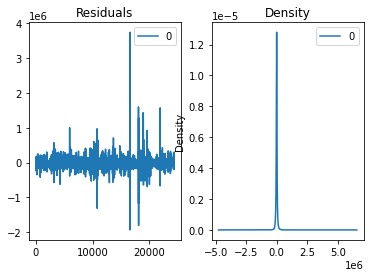

In [134]:
residuals = pd.DataFrame(model_fit_2.resid)
fig, ax = plt.subplots(1,2)
residuals.plot(title="Residuals", ax=ax[0])
residuals.plot(kind='kde', title='Density', ax=ax[1])
plt.show()

<IPython.core.display.Javascript object>

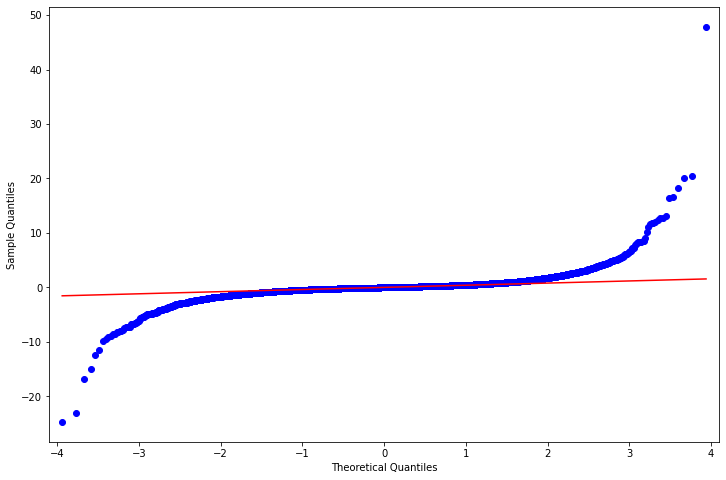

In [135]:
resid = model_fit_2.resid
stats.normaltest(resid)
fig = plt.figure(figsize=(12,8))
ax = fig.add_subplot(111)
fig = qqplot(resid, line='q', ax=ax, fit=True)

<IPython.core.display.Javascript object>

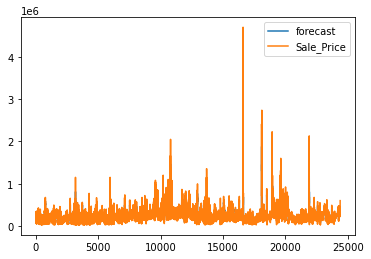

In [136]:
model_fit_2.plot_predict(dynamic=False)
plt.show()